<a href="https://colab.research.google.com/github/nitrogenlab/GP15_watermassanalysis/blob/main/GP02_ompa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

GP02 data

https://geotraces.webodv.awi.de/IDP2021%3EGEOTRACES_IDP2021_Seawater_Discrete_Sample_Data_v1/service/DataExtraction

In [1]:
!pip install gsw

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 8.5 MB/s eta 0:00:00


In [2]:
import gsw

In [3]:
!pip uninstall -y pyompa
%cd /content/
!rm -rf pyompa
!git clone https://github.com/nitrogenlab/pyompa
%cd /content/pyompa
!git checkout devsmallchanges
!git log -1
!pip install .
%cd /content/

%reload_ext autoreload
%autoreload 2
from importlib import reload
import pyompa
reload(pyompa)

/content
Cloning into 'pyompa'...
remote: Enumerating objects: 1408, done.
remote: Counting objects: 100% (164/164), done.
remote: Compressing objects: 100% (70/70), done.
remote: Total 1408 (delta 160), reused 94 (delta 94), pack-reused 1244
Receiving objects: 100% (1408/1408), 16.71 MiB | 11.63 MiB/s, done.
Resolving deltas: 100% (999/999), done.
/content/pyompa
Branch 'devsmallchanges' set up to track remote branch 'devsmallchanges' from 'origin'.
Switched to a new branch 'devsmallchanges'
commit 59e32a23bdfbed0a3261fd575e2be9d94a6779b2 (HEAD -> devsmallchanges, origin/devsmallchanges)
Author: Av Shrikumar <avanti.shrikumar@gmail.com>
Date:   Tue Feb 8 12:28:04 2022 -0800

    adding code to return bailedon indices
Processing /content/pyompa
  Preparing metadata (setup.py) ... done
  Created wheel for pyompa: filename=pyompa-0.4.1.0-py3-none-any.whl size=27839 sha256=45c76259f7e98059e7671c70cd62f54a492e57563a1aaa8b3d9f8b66a6f6e4c5
  Stored in directory: /tmp/pip-ephem-wheel-cache-ks

<module 'pyompa' from '/usr/local/lib/python3.10/dist-packages/pyompa/__init__.py'>

In [4]:
%reload_ext autoreload
%autoreload 2
from importlib import reload
import pyompa
reload(pyompa)

<module 'pyompa' from '/usr/local/lib/python3.10/dist-packages/pyompa/__init__.py'>

In [6]:
import pandas as pd
import numpy as np
from collections import OrderedDict

In [14]:
#!wget 'https://github.com/nitrogenlab/gp15wmascripts/blob/main/GP02wma/bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv' -O bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv
#above not working so either get from google drive or upload directly.

--2023-09-04 16:58:35--  https://github.com/nitrogenlab/gp15wmascripts/blob/main/GP02wma/bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv
Resolving github.com (github.com)... 140.82.121.3
Connecting to github.com (github.com)|140.82.121.3|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5511 (5.4K) [text/plain]
Saving to: ‘bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv’

bottleGP02_IDP2021_ 100%[===================>]   5.38K  --.-KB/s    in 0s      

2023-09-04 16:58:35 (54.3 MB/s) - ‘bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv’ saved [5511/5511]



In [18]:
GP02_df = pd.read_csv("bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv")
GP02_df.head()

,Cruise,Station,Type,yyyy-mm-ddThh:mm:ss.sss,Longitude [degrees_east],Latitude [degrees_north],CTDPRS_T_VALUE_SENSOR [dbar],QV:SEADATANET,DEPTH [m],QV:SEADATANET.1,...,QV:SEADATANET.50,DOC_D_CONC_BOTTLE [umol/kg],QV:SEADATANET.51,DOC_D_CONC_FISH [umol/kg],QV:SEADATANET.52,DOC_D_CONC_UWAY [umol/kg],QV:SEADATANET.53,TDN_D_CONC_BOTTLE [umol/kg],QV:SEADATANET.54,QV:ODV:SAMPLE
0,GP02,BD02,B,2012-08-24T02:26:00,141.453,37.3313,0.000,0,0.0,0,...,9,NaN,9,NaN,9,NaN,9,NaN,9,1
1,GP02,BD02,B,2012-08-24T02:26:00,141.453,37.3313,10.079,0,10.0,0,...,9,NaN,9,NaN,9,NaN,9,NaN,9,1
2,GP02,BD02,B,2012-08-24T02:26:00,141.453,37.3313,10.079,0,10.0,0,...,9,NaN,9,NaN,9,NaN,9,NaN,9,1
3,GP02,BD02,B,2012-08-24T02:26:00,141.453,37.3313,10.079,0,10.0,0,...,9,NaN,9,NaN,9,NaN,9,NaN,9,1
4,GP02,BD02,B,2012-08-24T02:26:00,141.453,37.3313,10.079,0,10.0,0,...,9,NaN,9,NaN,9,NaN,9,NaN,9,1


In [29]:
colnames_subset = ['Cruise', 'Station', 'Latitude [degrees_north]', 'Longitude [degrees_east]', 'yyyy-mm-ddThh:mm:ss.sss',
                       'DEPTH [m]', 'CTDPRS_T_VALUE_SENSOR [dbar]', 'CTDTMP_T_VALUE_SENSOR [deg C]', 'CTDSAL_D_CONC_SENSOR [pss-78]',
                   'QV:SEADATANET','OXYGEN_D_CONC_BOTTLE [umol/kg]','QV:SEADATANET','SILICATE_D_CONC_BOTTLE [umol/kg]',
                   'QV:SEADATANET', 'PHOSPHATE_D_CONC_BOTTLE [umol/kg]', 'QV:SEADATANET']
#'NITRATE_D_CONC_BOTTLE [umol/kg]', 'QV:SEADATANET', remove because not nitrate data from this cruise

GP02_df = pd.read_csv("bottleGP02_IDP2021_v2_GEOTRACES_Seawater_Discrete_Sample_Data_v2_wlG854xv.csv", na_values = -9999)[colnames_subset]

GP02_df = GP02_df.assign(Station=GP02_df['Station'].str.replace(r'\D', ''))
GP02_df['Station'] = GP02_df['Station'].astype(int)

GP02_columns =['cruise', 'stnnbr',"lat", 'lon', 'year', 'depth',
             'CTD pressure', 'temperature', 'salinity', "salinity flag",
             'oxygen', "oxygen flag", 'silicate', "silicate flag",'phosphate', "phosphate flag"]
    #no nitrate, so removed 'nitrate', "nitrate flag",
GP02_df.columns= GP02_columns

absolute_salinity = np.array((gsw.SA_from_SP(SP=GP02_df["salinity"],
              p=GP02_df["CTD pressure"],
              lon=GP02_df["lon"],
              lat=GP02_df["lat"])))
GP02_df["absolute_salinity"] = absolute_salinity

conservative_temp = gsw.CT_from_t(SA=absolute_salinity,
               t=np.array(GP02_df["temperature"]),
               p=np.array(GP02_df["CTD pressure"]))
GP02_df["conservative_temp"] = conservative_temp

potential_temp = gsw.pt_from_CT(SA=absolute_salinity,
                                CT=conservative_temp)
GP02_df["potential_temp"] = potential_temp

sig0 = gsw.rho(SA=np.array(absolute_salinity), CT=np.array(conservative_temp), p=0) - 1000
GP02_df["sigma0"] = sig0

z = gsw.z_from_p(p=np.array(GP02_df["CTD pressure"]), lat=np.array(GP02_df["lat"]))
depth = -z #https://github.com/TEOS-10/python-gsw/blob/7d6ebe8114c5d8b4a64268d36100a70e226afaf6/gsw/gibbs/conversions.py#L577
GP02_df["Depth"] = depth

print("Rows in gp02 datafile:",len(GP02_df))
test = GP02_df.dropna()
print("Rows without NA values:",len(test))
p = GP02_df["phosphate"].dropna()
print("Rows without NA phosphate values:",len(p))
si = GP02_df["silicate"].dropna()
print("Rows without NA silicate values:",len(si))
ox = GP02_df["oxygen"].dropna()
print("Rows without NA oxygen values:",len(ox))
#oxygen is limiting factor here with only 845 data points
temp = GP02_df["conservative_temp"].dropna()
print("Rows without NA temp values:",len(temp))
sal = GP02_df["absolute_salinity"].dropna()
print("Rows without NA salinity values:",len(sal))

print("Rows in gp02 datafile:",len(GP02_df))
GP02_df = GP02_df.dropna()
print("Rows without NA values:",len(GP02_df))

Rows in gp02 datafile: 3851
Rows without NA values: 800
Rows without NA phosphate values: 944
Rows without NA silicate values: 919
Rows without NA oxygen values: 845
Rows without NA temp values: 3816
Rows without NA salinity values: 3816
Rows in gp02 datafile: 3851
Rows without NA values: 800


<ipython-input-29-d1c3a79bfa6f>:9: FutureWarning: The default value of regex will change from True to False in a future version.
  GP02_df = GP02_df.assign(Station=GP02_df['Station'].str.replace(r'\D', ''))


In [31]:
#filter based on flags?
GP02_df

,cruise,stnnbr,lat,lon,year,depth,CTD pressure,temperature,salinity,salinity flag,...,oxygen flag,silicate,silicate flag,phosphate,phosphate flag,absolute_salinity,conservative_temp,potential_temp,sigma0,Depth
18,GP02,2,37.3313,141.45300,2012-08-24T02:26:00,75.0,75.606,15.0608,34.012299,0,...,0,2.800000,0,0.234146,0,34.174088,15.063655,15.049454,25.204841,75.031078
20,GP02,2,37.3313,141.45300,2012-08-24T02:26:00,99.0,99.805,10.6690,34.033298,0,...,0,7.024390,0,0.565854,0,34.195405,10.665332,10.657116,26.087569,99.040253
22,GP02,2,37.3313,141.45300,2012-08-24T02:26:00,133.0,134.092,9.4987,34.043499,0,...,0,13.892683,0,0.848780,0,34.205973,9.490879,9.483853,26.294726,133.053477
24,GP02,2,37.3313,141.45300,2012-08-24T02:26:00,134.0,135.101,9.4750,34.049900,0,...,0,14.790244,0,0.868293,0,34.212414,9.466958,9.460063,26.303625,134.054335
43,GP02,3,37.5845,141.51601,2012-08-24T06:08:00,50.0,50.402,14.1123,33.918499,0,...,0,1.721452,0,0.220404,0,34.079610,14.120090,14.105082,25.334173,50.020664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3842,GP02,1,35.9997,141.01801,2012-08-23T17:31:59,100.0,100.802,14.9697,34.529800,0,...,0,14.956098,0,0.819512,0,34.693919,14.955694,14.954561,25.624203,100.041144
3844,GP02,1,35.9997,141.01801,2012-08-23T17:31:59,149.0,150.212,12.3760,34.420601,0,...,0,24.029268,0,1.151220,0,34.584578,12.357798,12.356151,26.075173,149.060349
3846,GP02,1,35.9997,141.01801,2012-08-23T17:31:59,198.0,199.632,10.3143,34.256302,0,...,0,26.760977,0,1.258537,0,34.420081,10.294543,10.290864,26.325593,198.077756
3848,GP02,1,35.9997,141.01801,2012-08-23T17:31:59,249.0,251.081,8.8071,34.208900,0,...,0,42.370731,0,1.648780,0,34.372968,8.784074,8.780338,26.537350,249.095201


In [20]:
! wget https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP15_intermediateanddeep_endmemberswithsubtypes.csv -O GP15_intermediateanddeep_endmemberswithsubtypes.csv

--2023-09-04 17:06:38--  https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP15_intermediateanddeep_endmemberswithsubtypes.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2363 (2.3K) [text/plain]
Saving to: ‘GP15_intermediateanddeep_endmemberswithsubtypes.csv’

GP15_intermediatean 100%[===================>]   2.31K  --.-KB/s    in 0s      

2023-09-04 17:06:39 (33.7 MB/s) - ‘GP15_intermediateanddeep_endmemberswithsubtypes.csv’ saved [2363/2363]



In [22]:
import pandas
endmember_df = pandas.read_csv("GP15_intermediateanddeep_endmemberswithsubtypes.csv")

def augment_df_with_PO_NO_SiO(df):
    #remineralization ratios
    r_PO = 155;
    r_SiO = 15
    r_NO = 9.68
    df["PO"] = df["oxygen"] + df["phosphate"]*r_PO
    df["NO"] = df["oxygen"] + df["nitrate"]*r_NO
    df["SiO"] = df["oxygen"] + df["silicate"]*r_SiO
    return df

endmember_df = augment_df_with_PO_NO_SiO(endmember_df)

In [23]:
endmember_df

,watermass_name,conservative_temp,absolute_salinity,silicate,nitrate,phosphate,oxygen,latitude,longitude,PO,NO,SiO
0,AABW_0,0.071010,34.874306,128.232648,32.464573,2.256264,216.226644,-63.780499,-119.014188,565.947599,530.483711,2139.716361
1,AAIW_0,5.041524,34.387770,11.507361,23.991849,1.670313,272.309846,-52.777285,-85.089895,531.208332,504.550945,444.920262
2,AAIW_1,4.472442,34.404032,20.434864,28.544062,1.994464,231.454546,-50.717771,-86.192849,540.596412,507.761071,537.977505
3,ENPCW_0,15.987926,34.795953,3.538626,3.510966,0.320541,213.720180,24.481807,-151.785940,263.404069,247.706334,266.799569
4,ENPCW_1,8.553011,34.203434,28.661457,21.545892,1.568647,177.507909,25.189481,-150.783807,420.648191,386.072142,607.429770
5,EqIW_0,5.457477,34.733055,72.170881,42.522378,3.056619,42.817594,-3.463370,-85.834079,516.593531,454.434213,1125.380808
6,EqIW_1,8.738920,34.843496,44.153200,38.849223,2.845376,8.044958,-1.594136,-85.834445,449.078254,384.105437,670.342956
7,LCDW_0,1.549640,34.904359,93.312283,31.500983,2.181685,190.095497,-64.060684,-143.667295,528.256602,495.025015,1589.779742
8,LCDW_1,0.766669,34.885135,119.824941,32.425683,2.258798,199.089300,-65.264165,-119.820826,549.203027,512.969913,1996.463422
9,NPIW_0,9.413380,34.342944,32.630000,19.840000,1.410000,177.000000,37.029000,149.660000,395.550000,369.051200,666.450000


In [32]:
import json

!wget https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP02_station_to_tc_cutoffs.json -O station_to_tc_cutoffs.json
station_to_tcstartend = json.loads(open("station_to_tc_cutoffs.json").read())

GP02_intermediateanddeep = GP02_df[GP02_df.apply(lambda x: x['Depth'] > station_to_tcstartend[str(float(x['stnnbr']))]['depth_cutoffs'][1], axis=1)]

GP02_intermediateanddeep['tc'] = 0

--2023-09-04 17:12:07--  https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP02_station_to_tc_cutoffs.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8026 (7.8K) [text/plain]
Saving to: ‘station_to_tc_cutoffs.json’

station_to_tc_cutof 100%[===================>]   7.84K  --.-KB/s    in 0s      

2023-09-04 17:12:07 (56.5 MB/s) - ‘station_to_tc_cutoffs.json’ saved [8026/8026]



<ipython-input-32-dc0fdf556759>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  GP02_intermediateanddeep['tc'] = 0


Visualize the end-members

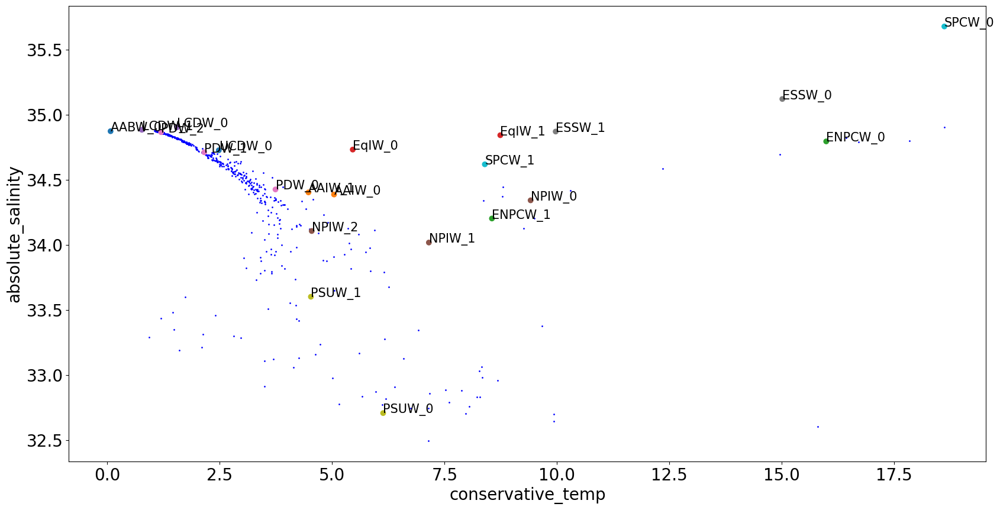

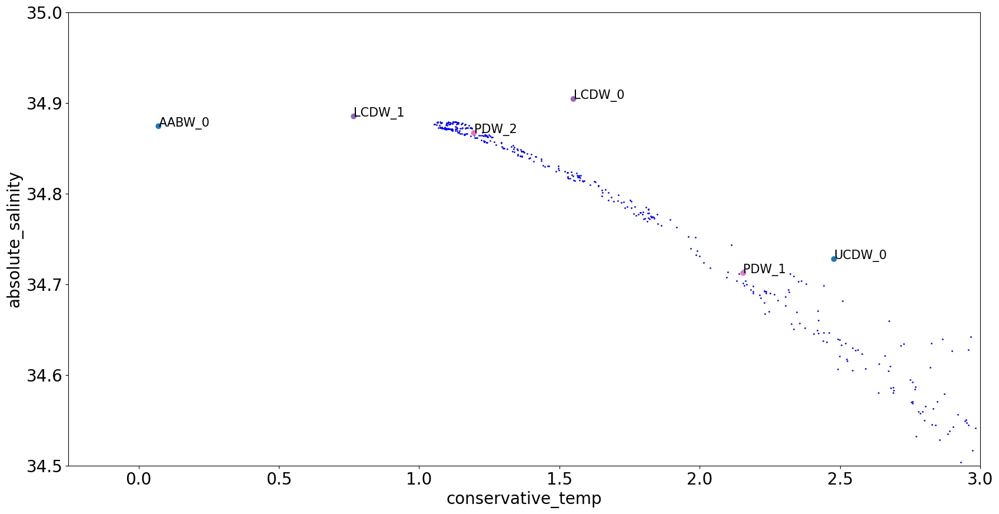

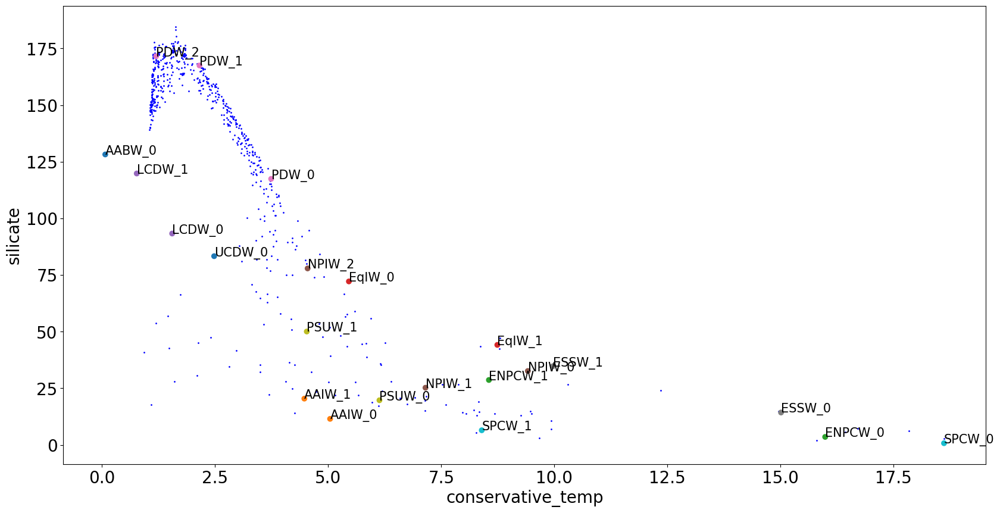

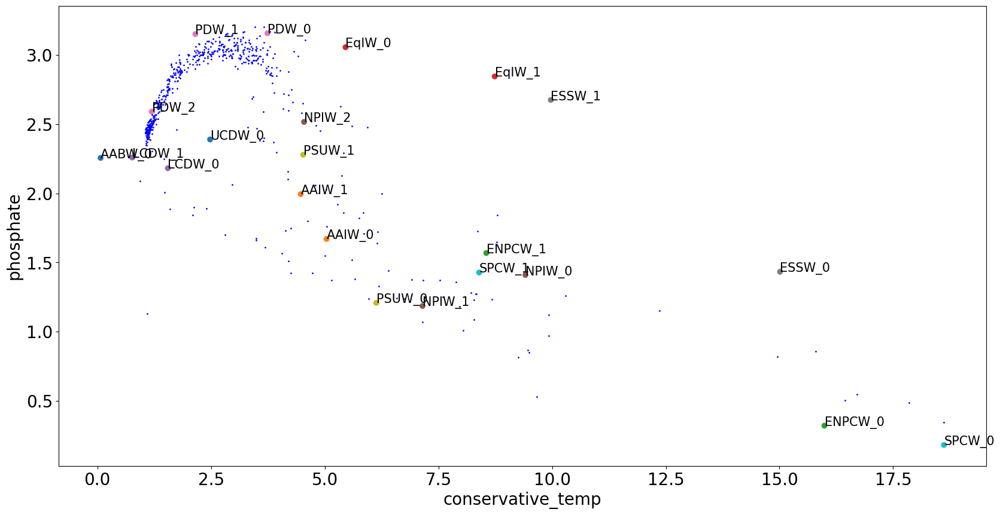

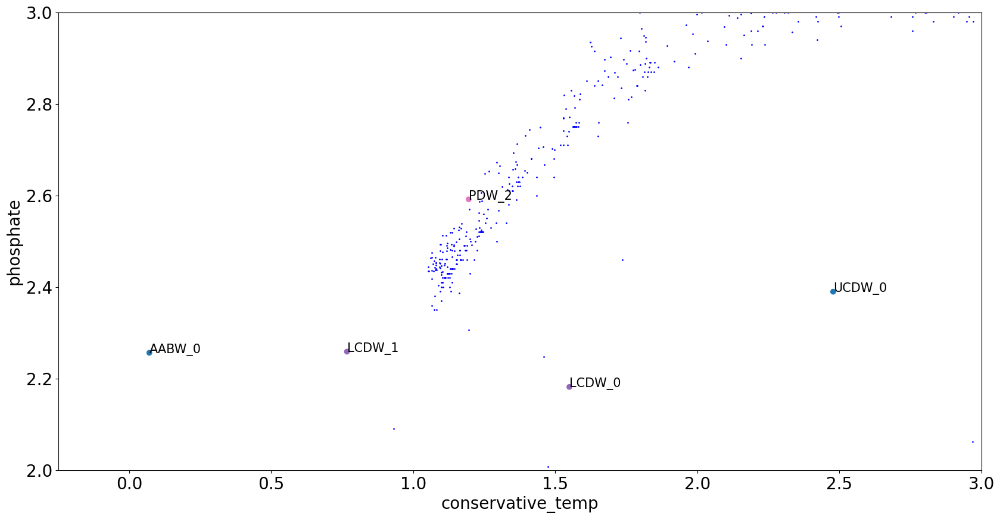

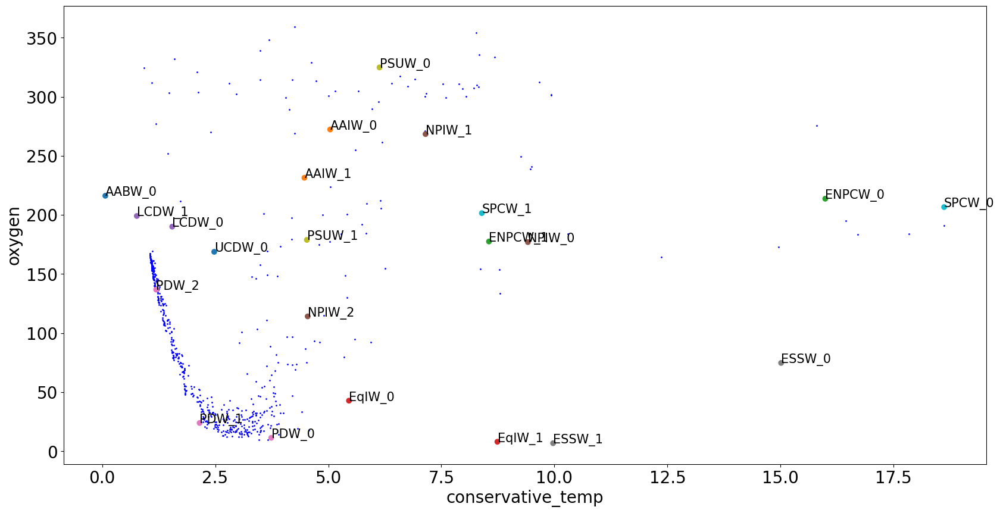

In [35]:
import matplotlib
from matplotlib import pyplot as plt
import pyompa

matplotlib.rc('axes', labelsize=20)
matplotlib.rc('xtick', labelsize=20)
matplotlib.rc('ytick', labelsize=20)

endmember_names = endmember_df["watermass_name"]
endmembername_to_indices = pyompa.util.get_endmember_idx_mapping(
                            endmember_names)

colors = ["C0"]*len(endmember_names)
for endmembertypeidx, endmembertype in enumerate(
      endmembername_to_indices.keys()):
  for idx in endmembername_to_indices[endmembertype]:
    colors[idx] = "C"+str(endmembertypeidx)

def make_paired_feature_plot(feature1name, feature2name, xlim=None, ylim=None):
    feature1vals = endmember_df[feature1name]
    feature2vals = endmember_df[feature2name]
    obsdf_feature1vals = GP02_intermediateanddeep[feature1name]
    obsdf_feature2vals = GP02_intermediateanddeep[feature2name]

    plt.figure(figsize=(20,10))

    ax = plt.gca()
    for i, txt in enumerate(endmember_names):
        plotme = True
        if (xlim is not None and (feature1vals[i] < xlim[0] or feature1vals[i]>xlim[1])):
            plotme = False
        if (ylim is not None and (feature2vals[i] < ylim[0] or feature2vals[i]>ylim[1])):
            plotme = False
        if (plotme):
            ax.annotate(txt, (feature1vals[i], feature2vals[i]), size=15)
    plt.scatter(obsdf_feature1vals, obsdf_feature2vals, color="blue", s=1)
    plt.scatter(feature1vals, feature2vals, color=colors)
    plt.xlabel(feature1name)
    plt.ylabel(feature2name)
    if xlim is not None:
        plt.xlim(xlim[0], xlim[1])
    if ylim is not None:
        plt.ylim(ylim[0], ylim[1])
    plt.show()

#if you want to zoom into a region...


make_paired_feature_plot("conservative_temp", "absolute_salinity")
make_paired_feature_plot("conservative_temp", "absolute_salinity",
                         xlim=(-0.25, 3), ylim=(34.5,35))

make_paired_feature_plot("conservative_temp", "silicate")
#make_paired_feature_plot("conservative_temp", "nitrate")

make_paired_feature_plot("conservative_temp", "phosphate")
make_paired_feature_plot("conservative_temp", "phosphate",
                         xlim=(-0.25, 3), ylim=(2,3))

make_paired_feature_plot("conservative_temp", "oxygen")

matplotlib.rcParams.update(matplotlib.rcParamsDefault)


In [36]:
from collections import OrderedDict

intermediateanddeep_settingtosoln = OrderedDict()

In [38]:
import pyompa
reload(pyompa)
reload(pyompa.endmemberpenaltyfunc)
reload(pyompa)
from pyompa import OMPAProblem, GeneralPenaltyFunc
from collections import OrderedDict
import json


convertedparamgroups_staticremineralization = [
    pyompa.ConvertedParamGroup(
        groupname="phosphate_remin",
        conversion_ratios=[{"oxygen": -155, "phosphate": 1.0}],
        #"nitrate": 16.0 from above removed
        always_positive=False)
]

convertedparamgroups_flexibleremineralization = [
    pyompa.ConvertedParamGroup(
        groupname="phosphate_remin",
        conversion_ratios=[#Representing C:P = 66
                           {"oxygen": -155*(66.0/106.0),
                            "phosphate": 1.0}, #"nitrate": 16.0*(66.0/106.0 removed
                           #Representing C:P = 209
                           {"oxygen": -155*(209.0/106.0),
                            "phosphate": 1.0,} #"nitrate": 16.0*(209.0/106.0) removed
                          ],
        always_positive=False)
]

rian_weighting = {
    "conservative_temp": 140.0,
    "absolute_salinity": 100.0,
    "silicate": 30,
    #"nitrate": 20,
    "phosphate": 10,
    "oxygen": 20,
    "NO": 1.0,
    "PO": 0.5
}

withconversion_paramnames = ["conservative_temp", "absolute_salinity",
                             "silicate", "phosphate", "oxygen"]
                             #"nitrate", removed
noconversion_paramnames = ["conservative_temp", "absolute_salinity",
                           "silicate", "PO"] #NO removed

flexiblereminratio_settings = {
    "param_names": withconversion_paramnames,
    "param_weightings": rian_weighting,
    "convertedparam_groups": convertedparamgroups_flexibleremineralization}

staticreminratio_settings = {
    "param_names": withconversion_paramnames,
    "param_weightings": rian_weighting,
    "convertedparam_groups": convertedparamgroups_staticremineralization}

noremin_settings = {
    "param_names": noconversion_paramnames,
    "param_weightings": rian_weighting,
    "convertedparam_groups": []}

endmember_usagepenalty = {

    #"ENPCW_*": GeneralPenaltyFunc(
    #    spec={
    #        'sigma0':{'type':'linear_density_default', 'upperbound':27},
    #        'lat': {'type':'linear_latlon_default', 'lowerbound':0}
    #        }),

    "ENPCW_*": GeneralPenaltyFunc(
        spec={
            'sigma0':{'type':'exp_density_default', 'upperbound':27},
            'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'lowerbound':0}
            }),

    "SPCW_*": GeneralPenaltyFunc(
        spec={
            'sigma0':{'type':'exp_density_default', 'upperbound':27.4},
            'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'upperbound':5}
              }),

    "PSUW_*": GeneralPenaltyFunc(
        spec={#'sigma0':{'type':'density_default', 'upperbound':27.5},
              'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'lowerbound':20}
              #'Depth': {'type':'depth_default', 'upperbound':2000}
              }),

    "ESSW_*": GeneralPenaltyFunc(
        spec={'sigma0':{'type':'exp_density_default', 'upperbound':27.2},
              'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'lowerbound':-20, 'upperbound':20}
              #'Depth': {'type':'depth_default', 'upperbound':2000}
              }),

    "EqIW_*": GeneralPenaltyFunc(
        spec={'sigma0':{'type':'exp_density_default', 'upperbound':27.6},
              'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'lowerbound':-20, 'upperbound':20}
              #'Depth': {'type':'depth_default', 'upperbound':2000}
              }),

    "LCDW_*": GeneralPenaltyFunc(
        spec={'sigma0': {'type':'exp_density_default', 'lowerbound':27.7},
            'lat': {'type':'exp_latlon_default', 'upperbound':40}
            }),

    #"PDW_0": GeneralPenaltyFunc(
        #spec={'sigma0': {'type':'exp_density_default', 'lowerbound':27.2}}),
    #"PDW_1": GeneralPenaltyFunc(
        #spec={'sigma0': {'type':'exp_density_default', 'lowerbound':27.2}}),


    "AAIW_*": GeneralPenaltyFunc(
        spec={'sigma0':{'type':'exp_density_default', 'upperbound':27.6},
              'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'upperbound':10}
              #'Depth': {'type':'exp_depth_default', 'upperbound':2000}
              }),

    "NPIW_*": GeneralPenaltyFunc(
        spec={'lat': {'type':'exp_latlon_default', 'lowerbound':20}
              #{'lat': {'type':'exp_other',"alpha":0.03, "beta":50, 'lowerbound':10}
              #{'sigma0':{'type':'exp_density_default', 'lowerbound':26, 'upperbound':27.6},
              }),

    "UCDW_*": GeneralPenaltyFunc(
        spec={'sigma0': {'type':'exp_density_default', 'lowerbound':27.3},
            'lat': {'type':'exp_latlon_default', 'upperbound':40}
            }),

    "AABW_*": GeneralPenaltyFunc(
        spec={'sigma0': {'type':'exp_density_default', 'lowerbound':27.8},
            'lat': {'type':'exp_latlon_default', 'upperbound':30}
            }),
}


for setting_name, setting, endmember_df_touse, usagepenalty_touse in [
    ("flexiblereminratio_manyarchetypes", flexiblereminratio_settings, endmember_df, endmember_usagepenalty),

                              #("staticreminratio", staticreminratio_settings),
                              #("noremin_settings", noremin_settings)
                              ]:
    print("On setting:", setting_name)
    ompa_soln = OMPAProblem(
              obs_df=GP02_intermediateanddeep,
              endmembername_to_usagepenaltyfunc=usagepenalty_touse,
              **setting).solve(
                  endmember_df_touse,
                  endmember_name_column="watermass_name",
                  batch_size=100)
    intermediateanddeep_settingtosoln[setting_name] = ompa_soln

On setting: flexiblereminratio_manyarchetypes
Adding penalty for ENPCW_*
Adding penalty for SPCW_*
Adding penalty for PSUW_*
Adding penalty for ESSW_*
Adding penalty for EqIW_*
Adding penalty for LCDW_*
Adding penalty for AAIW_*
Adding penalty for NPIW_*
Adding penalty for UCDW_*
Adding penalty for AABW_*
Endmember-idx mapping is
 OrderedDict([('AABW', [0]), ('AAIW', [1, 2]), ('ENPCW', [3, 4]), ('EqIW', [5, 6]), ('LCDW', [7, 8]), ('NPIW', [9, 10, 11]), ('PDW', [12, 13, 14]), ('ESSW', [15, 16]), ('PSUW', [17, 18]), ('SPCW', [19, 20]), ('UCDW', [21])])
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and pre

Plotting endmember fractions
Setting: flexiblereminratio_manyarchetypes


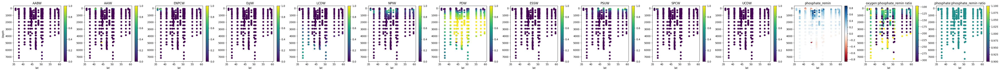

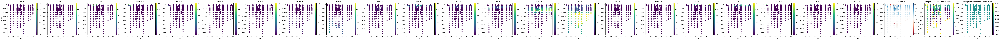

Plotting absolute residuals
Setting: flexiblereminratio_manyarchetypes


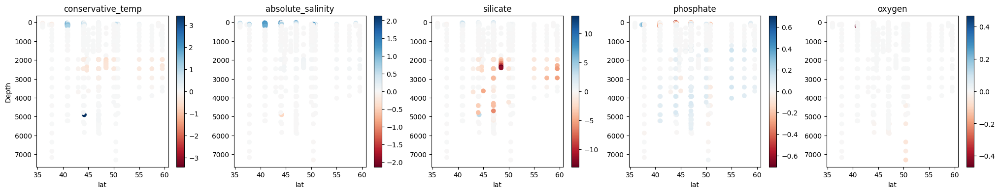

Plotting penalties
Setting: flexiblereminratio_manyarchetypes


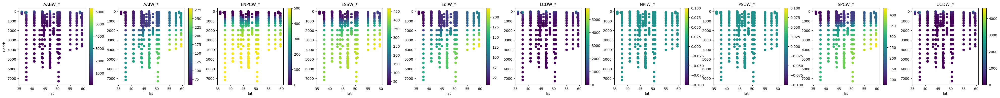

In [39]:
import numpy as np
from matplotlib import pyplot as plt
reload(pyompa)
from pyompa import (plot_ompasoln_endmember_fractions,
                    plot_ompasoln_residuals,
                    plot_ompasoln_endmember_usagepenalties)


print("Plotting endmember fractions")
for setting in intermediateanddeep_settingtosoln:
    print("Setting:", setting)
    ompa_soln = intermediateanddeep_settingtosoln[setting]
    plot_ompasoln_endmember_fractions(ompa_soln=ompa_soln,
                                      xaxis_colname="lat",
                                      yaxis_colname="Depth",
                                      group_endmembers=True)
    plot_ompasoln_endmember_fractions(ompa_soln=ompa_soln,
                                      xaxis_colname="lat",
                                      yaxis_colname="Depth",
                                      group_endmembers=False)


print("Plotting absolute residuals")
for setting in intermediateanddeep_settingtosoln:
    print("Setting:", setting)
    ompa_soln = intermediateanddeep_settingtosoln[setting]
    plot_ompasoln_residuals(ompa_soln=ompa_soln,
                            xaxis_colname="lat",
                            yaxis_colname="Depth")

print("Plotting penalties")
for setting in intermediateanddeep_settingtosoln:
    print("Setting:", setting)
    ompa_soln = intermediateanddeep_settingtosoln[setting]
    plot_ompasoln_endmember_usagepenalties(ompa_soln=ompa_soln,
                            xaxis_colname="lat",
                            yaxis_colname="Depth")

In [40]:
INTERANDDEEP_SETTINGTOUSE = "flexiblereminratio_manyarchetypes"

### Hybrid solution using OCIM and OMPA

In [43]:
#!wget raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/ocimandompa/endmemname_to_ocimfracs.npy -O endmemname_to_ocimfracs.npy

!wget raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP02_endmemname_to_ocimfracs.npy -O GP02_endmemname_to_ocimfracs.npy

URL transformed to HTTPS due to an HSTS policy
--2023-09-04 17:19:23--  https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/GP02_endmemname_to_ocimfracs.npy
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 59885 (58K) [application/octet-stream]
Saving to: ‘GP02_endmemname_to_ocimfracs.npy’

GP02_endmemname_to_ 100%[===================>]  58.48K  --.-KB/s    in 0.004s  

2023-09-04 17:19:25 (16.0 MB/s) - ‘GP02_endmemname_to_ocimfracs.npy’ saved [59885/59885]



In [46]:
endmemname_to_ocimfracs = np.load("GP02_endmemname_to_ocimfracs.npy", allow_pickle=True).item()

soln = intermediateanddeep_settingtosoln[INTERANDDEEP_SETTINGTOUSE]

#set up the matrices needed for enforcing the penalties
obj_weights = np.zeros((
    len(soln.endmembername_to_indices),
    len(soln.endmember_names) + soln.ompa_problem.num_converted_variables))
target_endmem_fracs = np.zeros((len(list(endmemname_to_ocimfracs.values())[0]),
                                len(soln.endmembername_to_indices)))

for endmemberoverallidx, (endmembername, endmember_idxs) in enumerate(soln.endmembername_to_indices.items()):
    obj_weights[endmemberoverallidx, endmember_idxs] = 1.0
    target_endmem_fracs[:, endmemberoverallidx] =\
      endmemname_to_ocimfracs[endmembername]

#compute the solution - setting resids to 0 constrains them to be no worse
# than what was obtained in the optimal pyompa soln
#assumed for 0.001, 0.004, 0.4, 0.1, 0.015, 0.2; removing 0.1
max_resids = 0.0*np.array([0.001, 0.004, 0.4, 0.015, 0.2])
ocim_pyompa_soln = pyompa.ompacore.OMPASoln.core_quantify_ambiguity_via_residual_limits(
    self=soln, obj_weights=obj_weights,
    max_resids=max_resids, retain_original_penalties=True,
    target_endmem_fracs=target_endmem_fracs,
    verbose=True, max_iter=1000000)

Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
On obs 0 out of 614
On obs 1 out of 614
On obs 2 out of 614
On obs 3 out of 614
On obs 4 out of 614
On obs 5 out of 614
On obs 6 out of 614
O

/usr/local/lib/python3.10/dist-packages/cvxpy/problems/problem.py:1387: UserWarning: Solution may be inaccurate. Try another solver, adjusting the solver settings, or solve with verbose=True for more information.
  warnings.warn(


On obs 110 out of 614
On obs 111 out of 614
On obs 112 out of 614
On obs 113 out of 614
On obs 114 out of 614
On obs 115 out of 614
On obs 116 out of 614
On obs 117 out of 614
On obs 118 out of 614
On obs 119 out of 614
On obs 120 out of 614
On obs 121 out of 614
On obs 122 out of 614
On obs 123 out of 614
On obs 124 out of 614
On obs 125 out of 614
On obs 126 out of 614
On obs 127 out of 614
On obs 128 out of 614
On obs 129 out of 614
On obs 130 out of 614
On obs 131 out of 614
On obs 132 out of 614
On obs 133 out of 614
On obs 134 out of 614
On obs 135 out of 614
On obs 136 out of 614
On obs 137 out of 614
On obs 138 out of 614
On obs 139 out of 614
On obs 140 out of 614
On obs 141 out of 614
On obs 142 out of 614
On obs 143 out of 614
On obs 144 out of 614
On obs 145 out of 614
On obs 146 out of 614
On obs 147 out of 614
On obs 148 out of 614
On obs 149 out of 614
On obs 150 out of 614
On obs 151 out of 614
On obs 152 out of 614
On obs 153 out of 614
On obs 154 out of 614
On obs 155

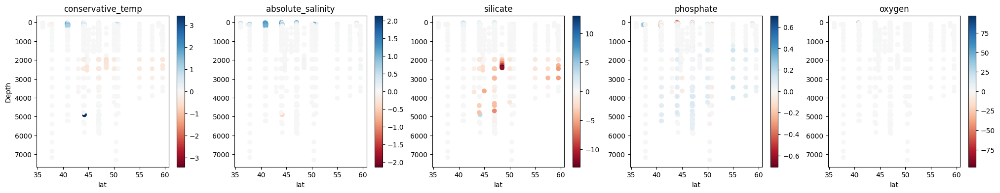

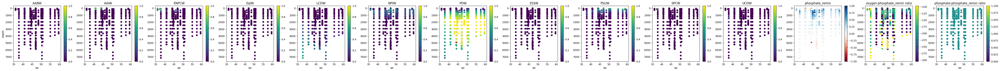

In [47]:
from pyompa import plot_ompasoln_residuals, plot_ompasoln_endmember_fractions
plot_ompasoln_residuals(ocim_pyompa_soln, xaxis_colname="lat", yaxis_colname="Depth")
plot_ompasoln_endmember_fractions(ocim_pyompa_soln, xaxis_colname="lat", yaxis_colname="Depth")

### Intermediate and deep waters uncertainty analysis

On AABW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

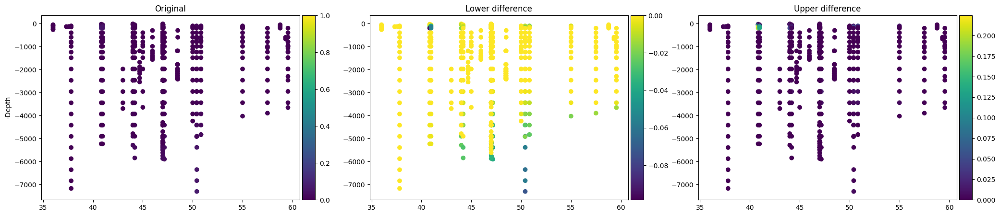

On AAIW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

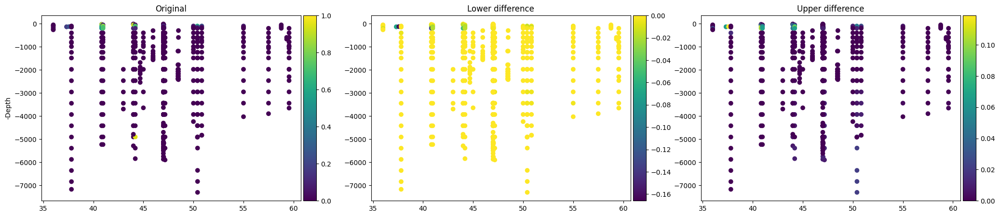

On ENPCW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix 

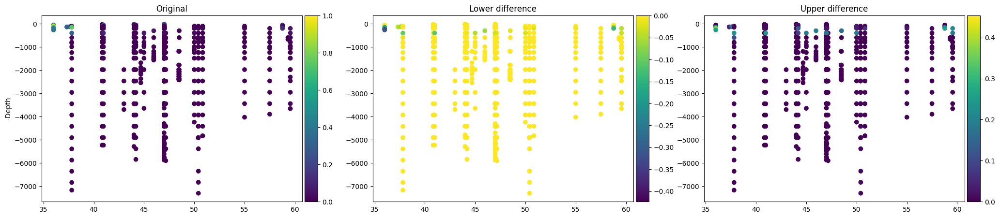

On EqIW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

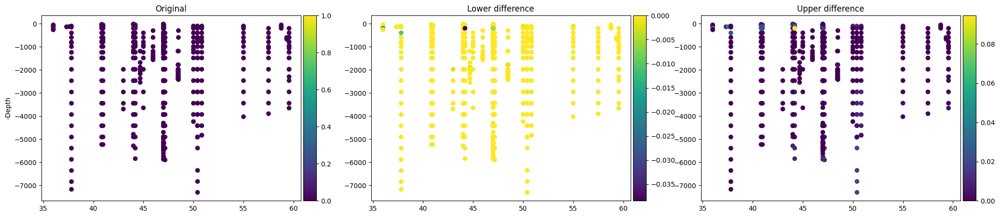

On LCDW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

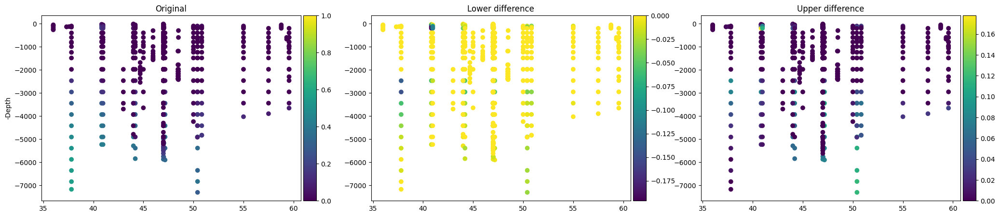

On NPIW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

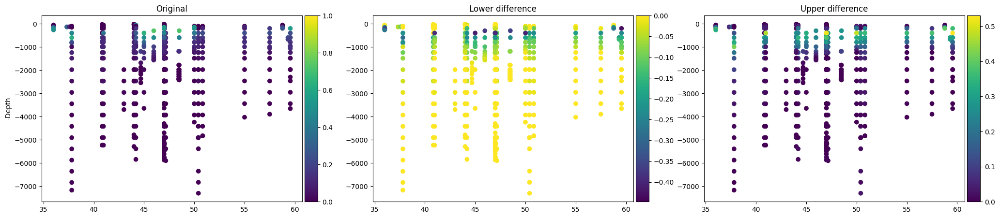

On PDW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SP

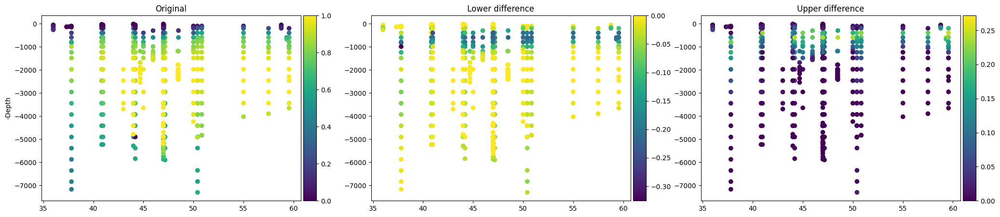

On ESSW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

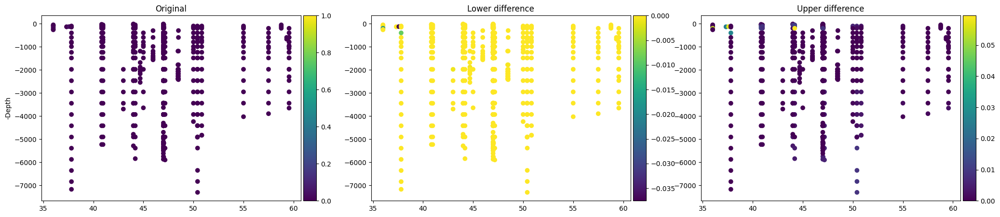

On PSUW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

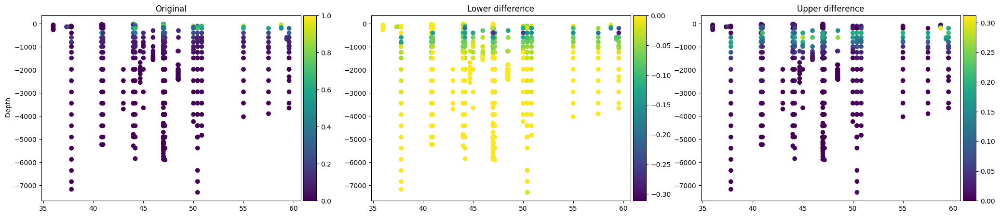

On SPCW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

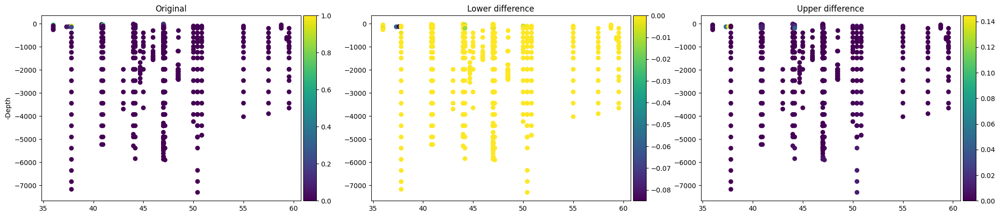

On UCDW
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix SPCW_*
Found match between SPCW_1 and prefix SPCW_*
Found match between PSUW_0 and prefix PSUW_*
Found match between PSUW_1 and prefix PSUW_*
Found match between ESSW_0 and prefix ESSW_*
Found match between ESSW_1 and prefix ESSW_*
Found match between EqIW_0 and prefix EqIW_*
Found match between EqIW_1 and prefix EqIW_*
Found match between LCDW_0 and prefix LCDW_*
Found match between LCDW_1 and prefix LCDW_*
Found match between AAIW_0 and prefix AAIW_*
Found match between AAIW_1 and prefix AAIW_*
Found match between NPIW_0 and prefix NPIW_*
Found match between NPIW_1 and prefix NPIW_*
Found match between NPIW_2 and prefix NPIW_*
Found match between UCDW_0 and prefix UCDW_*
Found match between AABW_0 and prefix AABW_*
Found match between ENPCW_0 and prefix ENPCW_*
Found match between ENPCW_1 and prefix ENPCW_*
Found match between SPCW_0 and prefix S

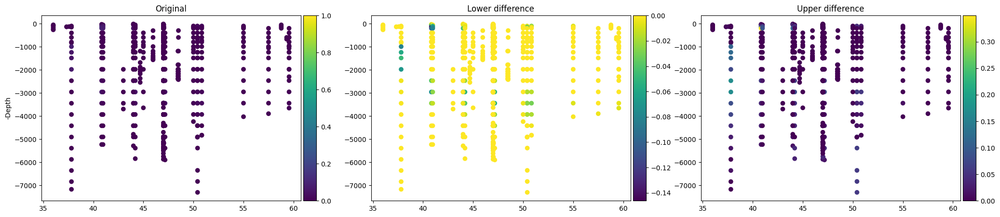

In [48]:
#quantify variation in min/max for each endmember and the remineralization amount
from mpl_toolkits.axes_grid1 import make_axes_locatable
reload(pyompa)
from pyompa.util import collapse_endmembers_by_idxmapping, organize_converted_vars_by_groupname
from pyompa.plotting import plot_residuals, plot_endmember_fractions

soln = intermediateanddeep_settingtosoln[INTERANDDEEP_SETTINGTOUSE]
#soln = intermediateanddeep_settingtosoln["flexiblereminratio_onearchetype"]

#max_resids = np.array([0.01, 0.04, 4, 1, 0.15, 2])
#max_resids = np.array([0.001, 0.004, 0.4, 0.1, 0.015, 0.2])
max_resids = 0.0*np.array([0.001, 0.004, 0.4, 0.015, 0.2])

interanddeep_ambiguity_results_max = {}
interanddeep_ambiguity_results_min = {}

for endmemberoverallidx, (endmembername, endmember_idxs) in enumerate(soln.endmembername_to_indices.items()):
    if (True):#endmembername in ["ESSW"]):
        print("On",endmembername)
        maximizing_obj = np.zeros((len(soln.endmember_names) + soln.ompa_problem.num_converted_variables,))
        maximizing_obj[endmember_idxs] = -1

        ompasoln_max = pyompa.ompacore.OMPASoln.core_quantify_ambiguity_via_residual_limits(
                                      self=soln, obj_weights=maximizing_obj,
                                      max_resids=max_resids)
        interanddeep_ambiguity_results_max[endmembername] = ompasoln_max

        minimizing_obj = np.zeros((len(soln.endmember_names) + soln.ompa_problem.num_converted_variables,))
        minimizing_obj[endmember_idxs] = 1
        ompasoln_min = pyompa.ompacore.OMPASoln.core_quantify_ambiguity_via_residual_limits(
                                      self=soln, obj_weights=minimizing_obj, max_resids=max_resids)
        interanddeep_ambiguity_results_min[endmembername] = ompasoln_min


        """print("Original")
        plot_ompasoln_endmember_fractions(ompa_soln=soln,
                                      xaxis_colname="lat",
                                      yaxis_colname="Depth",
                                      group_endmembers=True)

        print("With min fractions")
        plot_ompasoln_endmember_fractions(ompa_soln=ompasoln_min,
                                      xaxis_colname="lat",
                                      yaxis_colname="Depth",
                                      group_endmembers=True)
        print("With max fractions")
        plot_ompasoln_endmember_fractions(ompa_soln=ompasoln_max,
                                      xaxis_colname="lat",
                                      yaxis_colname="Depth",
                                      group_endmembers=True)"""

        print("original")
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(25,5))
        origscatter = ax[0].scatter(soln.obs_df["lat"], -soln.obs_df["Depth"],
                                    c=np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
                                    vmin=0, vmax=1.0)
        divider = make_axes_locatable(ax[0])
        cax = divider.append_axes('right', size='5%', pad=0.05)
        plt.colorbar(origscatter, cax=cax)
        ax[0].set_title("Original")
        ax[0].set_ylabel("-Depth")

        lowerscatter = ax[1].scatter(soln.obs_df["lat"], -soln.obs_df["Depth"],
                       c=np.sum(ompasoln_min.endmember_fractions[:,endmember_idxs], axis=1) - np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
                       )
        divider = make_axes_locatable(ax[1])
        cax = divider.append_axes('right', size='5%', pad=0.05)
        plt.colorbar(lowerscatter, cax=cax)
        ax[1].set_title("Lower difference")

        upperscatter = ax[2].scatter(soln.obs_df["lat"], -soln.obs_df["Depth"],
                               c=np.sum(ompasoln_max.endmember_fractions[:,endmember_idxs], axis=1) - np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
                               )
        divider = make_axes_locatable(ax[2])
        cax = divider.append_axes('right', size='5%', pad=0.05)
        plt.colorbar(upperscatter, cax=cax)
        ax[2].set_title("Upper difference")

        plt.show()

## Thermocline Analysis

In [49]:
#Thermocline files include endmembers in the range of potential density 21 to 27
#conservative temeprature added in place of PO column

!wget https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/ENPCW.csv -O ENPCW.csv
!wget https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/SPCW.csv -O SPCW.csv
!wget https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/PSUW.csv -O PSUW.csv
!wget https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/ESSW.csv -O ESSW.csv
!wget https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/SPSTSW.csv -O SPSTSW.csv

--2023-09-04 17:32:48--  https://github.com/nitrogenlab/GP15_watermassanalysis/raw/main/ENPCW.csv
Resolving github.com (github.com)... 140.82.121.4
Connecting to github.com (github.com)|140.82.121.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/ENPCW.csv [following]
--2023-09-04 17:32:49--  https://raw.githubusercontent.com/nitrogenlab/GP15_watermassanalysis/main/ENPCW.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.109.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 61159 (60K) [text/plain]
Saving to: ‘ENPCW.csv’

ENPCW.csv           100%[===================>]  59.73K  --.-KB/s    in 0.004s  

2023-09-04 17:32:49 (16.0 MB/s) - ‘ENPCW.csv’ saved [61159/61159]

--2023-09-04 17:32:49--  https://github.

Plotting for PSUW


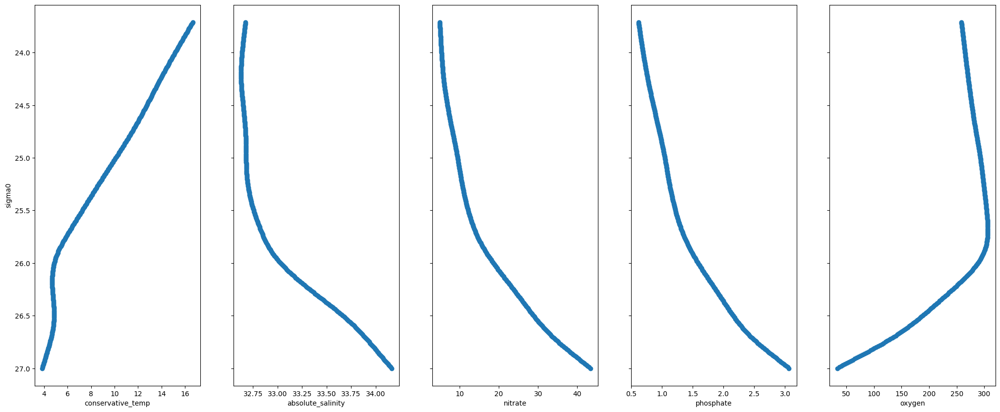

Plotting for ENPCW


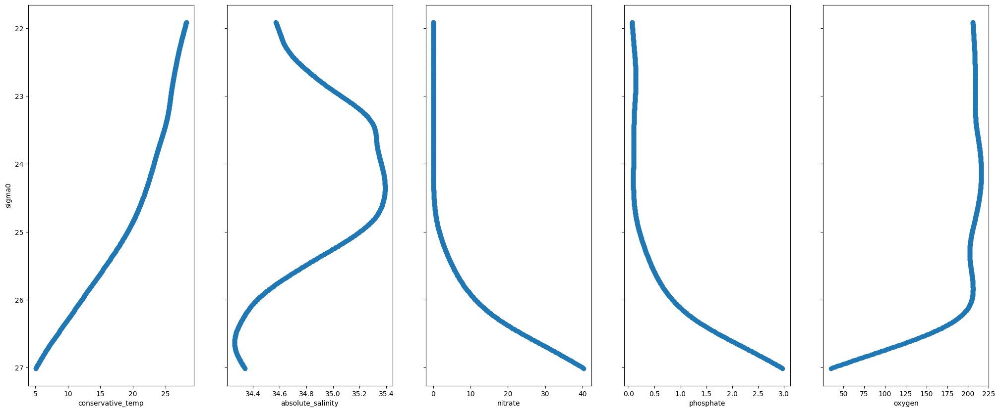

Plotting for ESSW


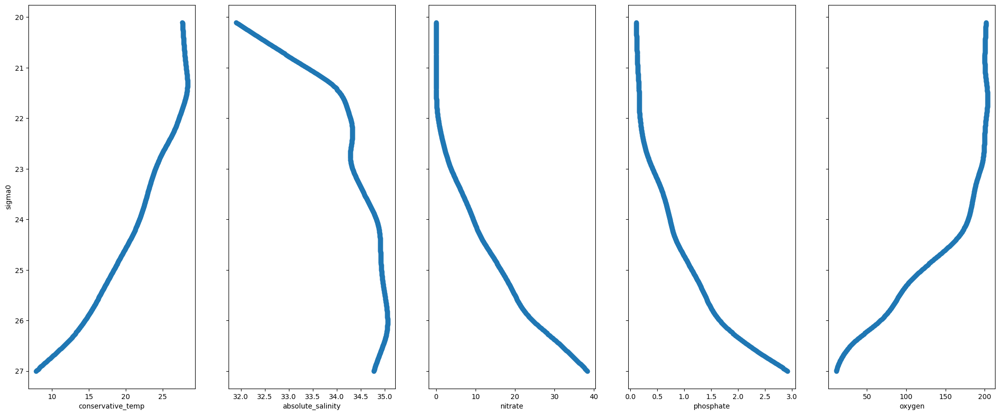

Plotting for SPCW


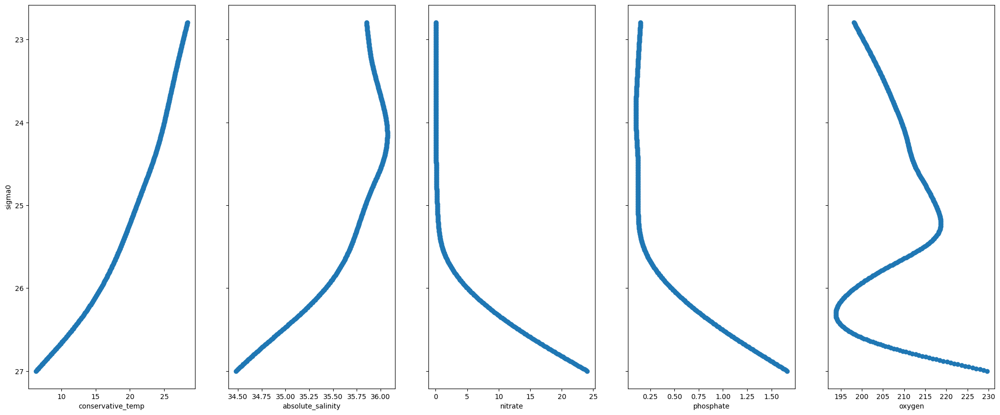

Plotting for SPSTSW


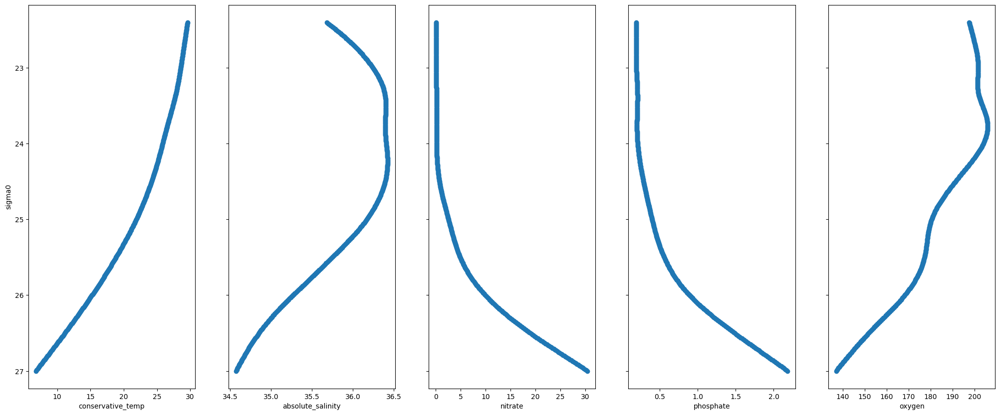

In [51]:
import pandas as pd
from matplotlib import pyplot as plt


def read_in_thermocline_endmemberdfs(endmemname_to_csv):
    #This function reads in the data frames for the thermocline end members
    #It takes endmemname_to_csv as input, which maps the thermocline
    # end member name (e.g. ENPCW) to the corresponding csv file.
    endmemname_to_df = {}
    #iterate through every endmemname in endmemname_to_csv
    #Order of thermocline endmember file columns: Sig0 pt SP O Si N P PO Pres spic0 vor NO Lat Lon T]);
    #e.g.
    header = ["c"+str(i) for i in range(1,17)]
    header[0] = "sigma0" #potential density
    header[1] = "potential_temp"
    header[2] = "practical_salinity"
    header[3] = "oxygen"
    header[4] = "silicate"
    header[5] = "nitrate"
    header[6] = "phosphate"
    header[7] = "CT"
    header[8] = "CTD pressure"
    header[9] = "latitude"
    header[10] = "longitude"
    header[11] = "CTD temperature"

    TOPLOT = ["conservative_temp", "absolute_salinity",
              "nitrate", "phosphate", "oxygen"]

    #make sure header names are compatible
    # with those used in the prepare_endmember_df function defined earlier
    # for intermediate waters.
    for endmemname in endmemname_to_csv.keys():
        #get the csv file corresponding to the endmemname
        csv = endmemname_to_csv[endmemname]
        #read the csv file into a data frame df
        df = pd.read_csv(csv)
        augment_df_with_PO_NO_SiO(df)
        #Also add a column to the df that just has the end member name
        # repeated for each row. This will come in handy later when
        # pairing rows from different data frames
        #df["watermassname"] = endmemname
        #store df in endmemname_to_df with the key endmemname
        endmemname_to_df[endmemname] = df;

        fig, ax = plt.subplots(nrows=1, ncols=len(TOPLOT),
                         sharey=True,
                         figsize=(len(TOPLOT)*5, 10))
        for idx,feature_name in enumerate(TOPLOT):
          plt.sca(ax[idx])
          plt.xlabel(feature_name)
          plt.scatter(df[feature_name], df["sigma0"])

        plt.sca(ax[0])
        plt.ylabel("sigma0")
        plt.ylim(plt.ylim()[1], plt.ylim()[0])

        print("Plotting for "+endmemname)
        plt.show()

    return endmemname_to_df


#To read in thermocline files via a for loop, first create a dictionary that maps the
# end member name (e.g. PSUW) to the paths for the csv files that
# should be used
endmemname_to_csv = {
    "PSUW": "PSUW.csv",
    "ENPCW": "ENPCW.csv",
    "ESSW": "ESSW.csv",
    "SPCW": "SPCW.csv",
    "SPSTSW": "SPSTSW.csv",
}
#Then, call a function that will run a for loop to read in
# the data frames for the thermocline endmembers.
#The function will return a dictionary that maps the
# thermocline end member to the corresponding dataframe
endmemname_to_df = read_in_thermocline_endmemberdfs(endmemname_to_csv)

t_endmember_usagepenalty = {
   "PSUW": GeneralPenaltyFunc(
       spec={
           'lat': {'type':'exp_other',"alpha":0.3, "beta":50, 'lowerbound':20}
           }),
   "ESSW": GeneralPenaltyFunc(
       spec={
           'lat': {'type':'exp_density_default', 'upperbound':20}
           }),
   "ENPCW": GeneralPenaltyFunc(
       spec={
           'lat': {'type':'exp_density_default','lowerbound':0}
           }),
   "SPCW": GeneralPenaltyFunc(
       spec={
           'lat': {'type':'exp_other',"alpha":0.3, "beta":50, 'upperbound':5}
           }),
   "SPSTSW": GeneralPenaltyFunc(
       spec={
           'lat': {'type':'exp_density_default', 'upperbound':0}
           }),
}

In [52]:
!pip uninstall -y pyompa
%cd /content/
!rm -rf pyompa
!git clone https://github.com/nitrogenlab/pyompa
%cd /content/pyompa
!git checkout dev
!git log -1
!pip install .
%cd /content/

%reload_ext autoreload
%autoreload 2
from importlib import reload
import pyompa
reload(pyompa)

Found existing installation: pyompa 0.4.1.0
Uninstalling pyompa-0.4.1.0:
  Successfully uninstalled pyompa-0.4.1.0
/content
Cloning into 'pyompa'...
remote: Enumerating objects: 1408, done.
remote: Counting objects: 100% (164/164), done.
remote: Compressing objects: 100% (70/70), done.
remote: Total 1408 (delta 160), reused 94 (delta 94), pack-reused 1244
Receiving objects: 100% (1408/1408), 16.71 MiB | 24.28 MiB/s, done.
Resolving deltas: 100% (999/999), done.
/content/pyompa
Branch 'dev' set up to track remote branch 'dev' from 'origin'.
Switched to a new branch 'dev'
commit e1490ff156ed8db745c73abf8daa9ea4aa3ac3b5 (HEAD -> dev, origin/dev)
Author: Av Shrikumar <avanti.shrikumar@gmail.com>
Date:   Mon Feb 28 08:58:09 2022 -0700

    updated with total parameter residual plots
Processing /content/pyompa
  Preparing metadata (setup.py) ... done
  Created wheel for pyompa: filename=pyompa-0.4.2.0-py3-none-any.whl size=27924 sha256=b919b36f6e9328885744ed15f3b64adc3ce7fd95f8580062480394b4

/content


<module 'pyompa' from '/usr/local/lib/python3.10/dist-packages/pyompa/__init__.py'>

In [56]:
reload(pyompa)
reload(pyompa.thermocline_array)
from pyompa import ThermoclineArrayOMPAProblem
from collections import OrderedDict

#Define thermocline
#By convention, constants are in all caps
#TC_UPPER_BOUND = 26.6
#TC_LOWER_BOUND = 25.5
TC_UPPER_BOUND = 27
TC_LOWER_BOUND = 22
TC_STEP = 0.01
#therm_endmem_to_use = ["PSUW","ENPCW","ESSW", "SPCW"] #thermocline water masses for analysis
# members to use in the analysis
GP02_thermocline =  GP02_df[GP02_df.apply(
        lambda x: (x['Depth'] > station_to_tcstartend[str(float(x['stnnbr']))]['depth_cutoffs'][0])
              and (x['Depth'] < station_to_tcstartend[str(float(x['stnnbr']))]['depth_cutoffs'][1]), axis=1)]
GP02_thermocline['tc'] = 1

rescale = 0.1 #for stabilizing the solver

thermocline_weighting = {
    "conservative_temp": rescale*200,
    "absolute_salinity": rescale*155,
    "silicate": rescale*5.0,
    #"nitrate": rescale*50,
    "phosphate": rescale*50,
    "oxygen": rescale*10
}

settings_to_thermoclineomparesults = OrderedDict()

for (t_settingname, t_weighting) in [
          ('thermocline_weighting', thermocline_weighting),
          ]:
    print("setting name", t_settingname)
    settings_to_thermoclineomparesults[(t_settingname)] = ThermoclineArrayOMPAProblem(
         endmembername_to_usagepenaltyfunc=t_endmember_usagepenalty,
         stratification_col="sigma0",
         tc_lower_bound=TC_LOWER_BOUND,
         tc_upper_bound=TC_UPPER_BOUND,
         tc_step=TC_STEP,
         obs_df=GP02_thermocline,
         param_names=withconversion_paramnames,
         convertedparam_groups=convertedparamgroups_flexibleremineralization,
         param_weightings=t_weighting
     ).solve(endmemname_to_df=endmemname_to_df, max_iter=100000, verbose=False)


<ipython-input-56-f2cce4fb7818>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  GP02_thermocline['tc'] = 1


setting name thermocline_weighting
Heads up! You specified a tc upper bound of 27 but the observations df contains samples with a sigma0 as high as 27.199052461692645
No observations for range 22.0 22.01
No observations for range 22.01 22.020000000000003
No observations for range 22.020000000000003 22.030000000000005
No observations for range 22.030000000000005 22.040000000000006
No observations for range 22.040000000000006 22.050000000000008
No observations for range 22.050000000000008 22.06000000000001
No observations for range 22.06000000000001 22.07000000000001
No observations for range 22.07000000000001 22.080000000000013
No observations for range 22.080000000000013 22.090000000000014
No observations for range 22.090000000000014 22.100000000000016
No observations for range 22.100000000000016 22.110000000000017
No observations for range 22.110000000000017 22.12000000000002
No observations for range 22.12000000000002 22.13000000000002
No observations for range 22.13000000000002 22.1

In [ ]:
plot_ompasoln_endmember_usagepenalties(settings_to_thermoclineomparesults['thermocline_weighting'], "lat", "Depth")

Plotting endmember fractions
thermocline_weighting


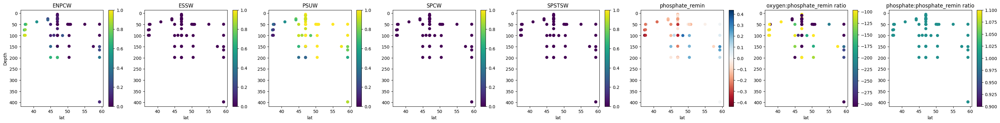

In [57]:
reload(pyompa)
from pyompa import plot_ompasoln_endmember_fractions

print("Plotting endmember fractions")
for setting,thermocline_ompa_results in\
  settings_to_thermoclineomparesults.items():
    print(setting)
    plot_ompasoln_endmember_fractions(
      ompa_soln=thermocline_ompa_results, xaxis_colname="lat", yaxis_colname="Depth")

In [ ]:
from pyompa import plot_ompasoln_residuals

print("Plotting parameter residuals")
for setting,thermocline_ompa_results in\
    settings_to_thermoclineomparesults.items():
    print(setting)
    plot_ompasoln_residuals(ompa_soln=thermocline_ompa_results,
                            xaxis_colname="lat", yaxis_colname="Depth")


In [58]:
THERMOCLINE_SETTINGTOUSE = "thermocline_weighting"

### Thermocline uncertainty analysis

In [59]:
reload(pyompa.ompacore)
reload(pyompa.thermocline_array)

#uncertainty analysis for the thermocline
soln = settings_to_thermoclineomparesults[THERMOCLINE_SETTINGTOUSE]
#max_resids = 10*np.array([0.001, 0.004, 0.4, 0.1, 0.015, 0.2])
#max_resids = np.array([0.001, 0.004, 0.4, 0.1, 0.015, 0.2])
#remove 0.1
max_resids = 0*np.array([0.001, 0.004, 0.4, 0.015, 0.2])

thermocline_ambiguity_results_max = {}
thermocline_ambiguity_results_min = {}

for endmemberoverallidx, (endmembername, endmember_idxs) in enumerate(soln.endmembername_to_indices.items()):
    if (True):#endmembername in ["ESSW"]):
        print("On",endmembername)

        ompasoln_max = (pyompa.thermocline_array.ThermoclineArraySoln
                              .with_endmemtype_names_quant_ambig_via_res_lim(
                         self=soln, endmemtypename_to_weight={endmembername: -1},
                         max_resids=max_resids))
        thermocline_ambiguity_results_max[endmembername] = ompasoln_max

        ompasoln_min = (pyompa.thermocline_array.ThermoclineArraySoln
                              .with_endmemtype_names_quant_ambig_via_res_lim(
                         self=soln, endmemtypename_to_weight={endmembername: 1},
                         max_resids=max_resids))
        thermocline_ambiguity_results_min[endmembername] = ompasoln_min

        #print("Original")
        #plot_ompasoln_endmember_fractions(ompa_soln=soln,
        #                              xaxis_colname="lat",
        #                              yaxis_colname="Depth",
        #                              group_endmembers=True)

        #print("With min fractions")
        #plot_ompasoln_endmember_fractions(ompa_soln=ompasoln_min,
        #                              xaxis_colname="lat",
        #                              yaxis_colname="Depth",
        #                              group_endmembers=True)
        #print("With max fractions")
        #plot_ompasoln_endmember_fractions(ompa_soln=ompasoln_max,
        #                              xaxis_colname="lat",
        #                              yaxis_colname="Depth",
        #                              group_endmembers=True)

        #plot_residuals(param_residuals=new_resids_max, param_names=soln.param_names,
        #               xaxis_vals=soln.obs_df["lat"], xaxis_label="lat",
        #               yaxis_vals=soln.obs_df["Depth"], yaxis_label="Depth")
        #plot_residuals(param_residuals=new_resids_min, param_names=soln.param_names,
        #               xaxis_vals=soln.obs_df["lat"], xaxis_label="lat",
        #               yaxis_vals=soln.obs_df["Depth"], yaxis_label="Depth")

On ENPCW
On ESSW
On PSUW
On SPCW
On SPSTSW


Plot the thermocline ambiguity results

original


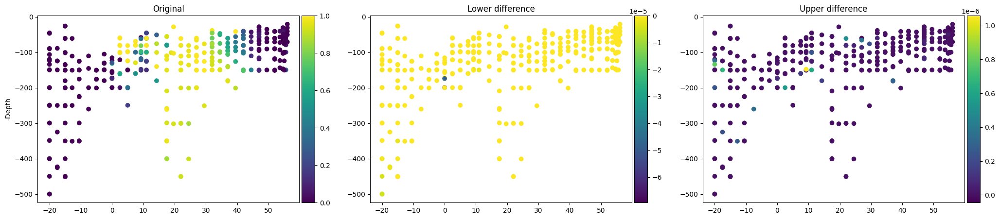

original


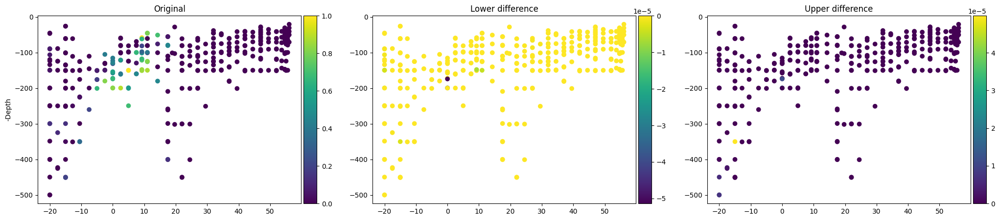

original


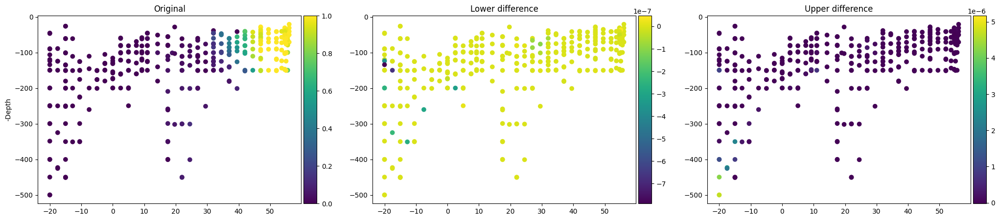

original


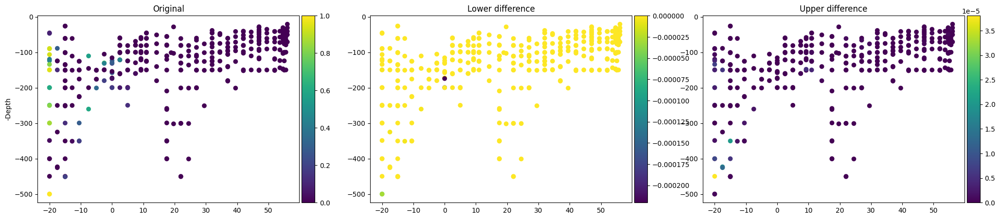

original


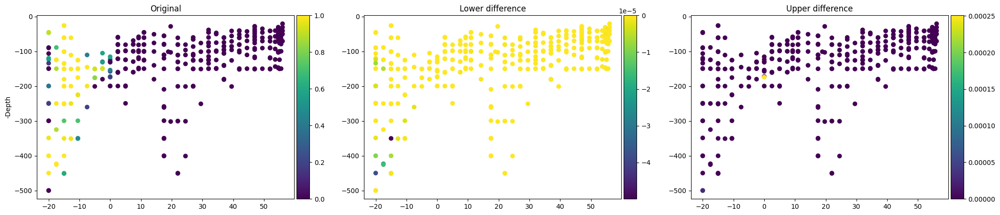

In [ ]:

soln = settings_to_thermoclineomparesults[THERMOCLINE_SETTINGTOUSE]
for endmemberoverallidx, (endmembername, endmember_idxs) in enumerate(soln.endmembername_to_indices.items()):

    ompasoln_min = thermocline_ambiguity_results_min[endmembername]
    ompasoln_max = thermocline_ambiguity_results_max[endmembername]

    print("original")
    fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(25,5))
    origscatter = ax[0].scatter(
        soln.obs_df["lat"], -soln.obs_df["Depth"],
        c=np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
        vmin=0, vmax=1.0)
    divider = make_axes_locatable(ax[0])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(origscatter, cax=cax)
    ax[0].set_title("Original")
    ax[0].set_ylabel("-Depth")

    lowerscatter = ax[1].scatter(
        soln.obs_df["lat"], -soln.obs_df["Depth"],
        c=np.sum(ompasoln_min.endmember_fractions[:,endmember_idxs], axis=1) - np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
        )
    divider = make_axes_locatable(ax[1])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(lowerscatter, cax=cax)
    ax[1].set_title("Lower difference")

    upperscatter = ax[2].scatter(
        soln.obs_df["lat"], -soln.obs_df["Depth"],
        c=np.sum(ompasoln_max.endmember_fractions[:,endmember_idxs], axis=1) - np.sum(soln.endmember_fractions[:,endmember_idxs], axis=1),
        )
    divider = make_axes_locatable(ax[2])
    cax = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(upperscatter, cax=cax)
    ax[2].set_title("Upper difference")

    plt.show()

## Combining the results for intermediate & deep and the thermocline, plot and export

In [61]:
reload(pyompa)
from collections import OrderedDict

ORIG_COLS_TO_INCLUDE = ["lat", "lon", "Depth", "CTD pressure", "temperature", "salinity", "stnnbr", "sigma0", "tc"]

base_intermediateanddeep =\
  ocim_pyompa_soln
base_thermocline =\
  settings_to_thermoclineomparesults[THERMOCLINE_SETTINGTOUSE]

base_combined = pyompa.ompacore.ExportToCsvMixin.merge(
  exptocsv1=base_intermediateanddeep, exptocsv2=base_thermocline)
base_combined.export_to_csv(
    csv_output_name="baseresults.csv",
    orig_cols_to_include=ORIG_COLS_TO_INCLUDE)

combined_ambiguity_results_max = OrderedDict()
combined_ambiguity_results_min = OrderedDict()

all_endmembertypes = sorted(set(
    list(interanddeep_ambiguity_results_max.keys())
    +list(thermocline_ambiguity_results_max.keys())))


for endmembername in all_endmembertypes:
  interanddeep_touse_max = base_intermediateanddeep
  interanddeep_touse_min = base_intermediateanddeep
  thermocline_touse_max = base_thermocline
  thermocline_touse_min = base_thermocline
  if endmembername in interanddeep_ambiguity_results_max:
    interanddeep_touse_max = interanddeep_ambiguity_results_max[endmembername]
    interanddeep_touse_min = interanddeep_ambiguity_results_min[endmembername]
  if endmembername in thermocline_ambiguity_results_max:
    thermocline_touse_max = thermocline_ambiguity_results_max[endmembername]
    thermocline_touse_min = thermocline_ambiguity_results_min[endmembername]

  combined_ambiguity_results_max[endmembername] =\
    pyompa.ompacore.ExportToCsvMixin.merge(
      exptocsv1=interanddeep_touse_max,
      exptocsv2=thermocline_touse_max)
  combined_ambiguity_results_max[endmembername].export_to_csv(
    csv_output_name="max_"+endmembername+"_results.csv",
    orig_cols_to_include=ORIG_COLS_TO_INCLUDE,
    #don't export the residuals cos they haven't been subject
    # to minimization beyond satisfying the constraints
    export_residuals=False)

  combined_ambiguity_results_min[endmembername] =\
    pyompa.ompacore.ExportToCsvMixin.merge(
      exptocsv1=interanddeep_touse_min,
      exptocsv2=thermocline_touse_min)
  combined_ambiguity_results_min[endmembername].export_to_csv(
    csv_output_name="min_"+endmembername+"_results.csv",
    orig_cols_to_include=ORIG_COLS_TO_INCLUDE,
    export_residuals=False)


#print(np.min([x['sig0_cutoffs'][1] for x in station_to_tcstartend.values()]))
#print(np.max([x['sig0_cutoffs'][1] for x in station_to_tcstartend.values()]))

writing to baseresults.csv
writing to max_AABW_results.csv
writing to min_AABW_results.csv
writing to max_AAIW_results.csv
writing to min_AAIW_results.csv
writing to max_ENPCW_results.csv
writing to min_ENPCW_results.csv
writing to max_ESSW_results.csv
writing to min_ESSW_results.csv
writing to max_EqIW_results.csv
writing to min_EqIW_results.csv
writing to max_LCDW_results.csv
writing to min_LCDW_results.csv
writing to max_NPIW_results.csv
writing to min_NPIW_results.csv
writing to max_PDW_results.csv
writing to min_PDW_results.csv
writing to max_PSUW_results.csv
writing to min_PSUW_results.csv
writing to max_SPCW_results.csv
writing to min_SPCW_results.csv
writing to max_SPSTSW_results.csv
writing to min_SPSTSW_results.csv
writing to max_UCDW_results.csv
writing to min_UCDW_results.csv


Plotting (warning: this can make the notebook very large, sometimes too large to save)

Base (original) plot


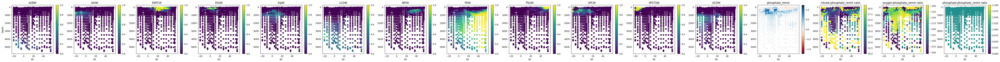

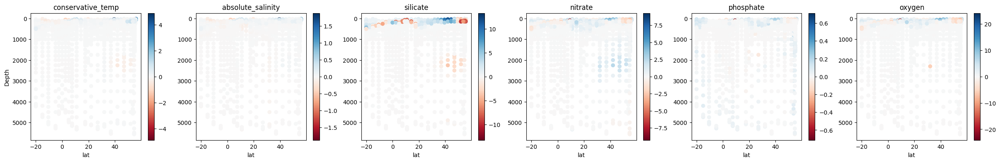

In [ ]:
print("Base (original) plot")

plot_ompasoln_endmember_fractions(ompa_soln=base_combined,
                                xaxis_colname="lat",
                                yaxis_colname="Depth",
                                group_endmembers=True)
plot_ompasoln_residuals(ompa_soln=base_combined,
                        xaxis_colname="lat",
                        yaxis_colname="Depth")


Uncertainty for endmembername: AABW
With min fractions


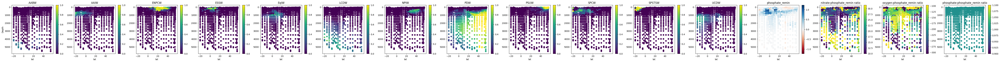

With max fractions


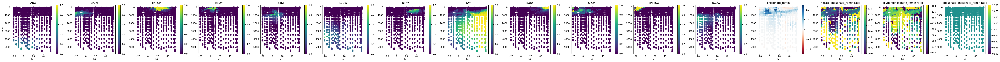

Uncertainty for endmembername: AAIW
With min fractions


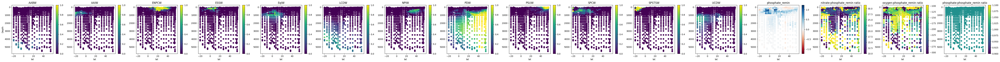

With max fractions


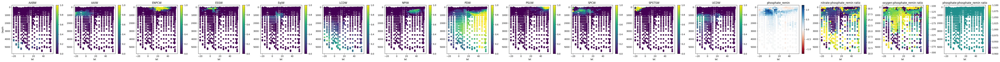

Uncertainty for endmembername: NPIW
With min fractions


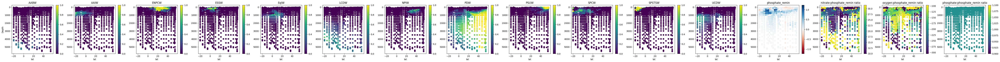

With max fractions


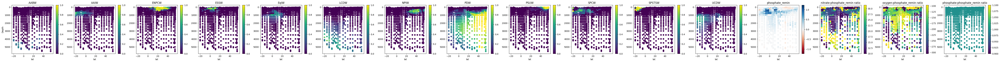

Uncertainty for endmembername: EqIW
With min fractions


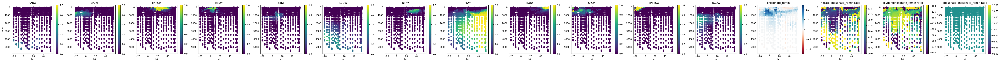

With max fractions


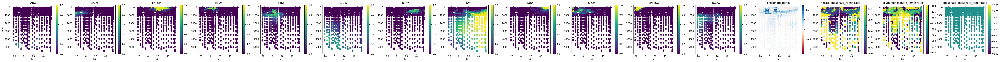

Uncertainty for endmembername: UCDW
With min fractions


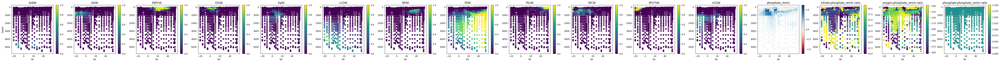

With max fractions


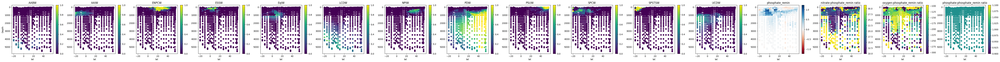

Uncertainty for endmembername: LCDW
With min fractions


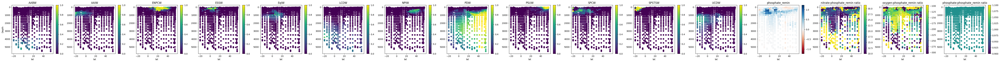

With max fractions


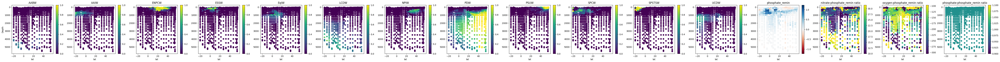

Uncertainty for endmembername: PDW
With min fractions


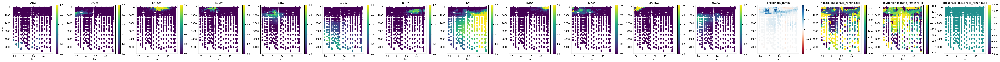

With max fractions


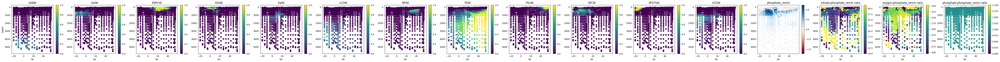

Uncertainty for endmembername: PSUW
With min fractions


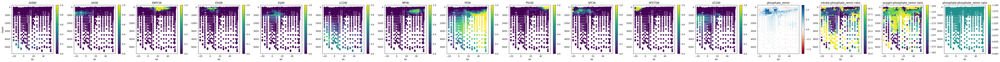

With max fractions


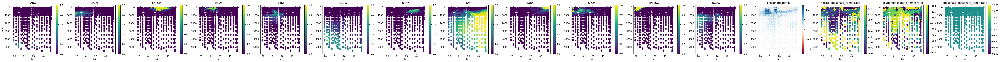

Uncertainty for endmembername: ENPCW
With min fractions


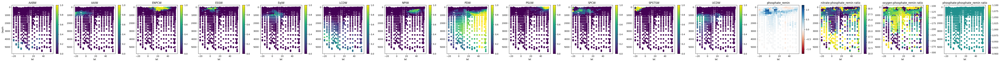

With max fractions


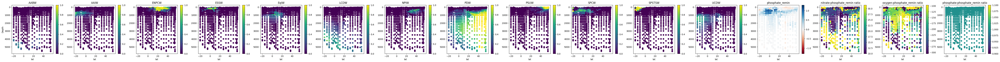

Uncertainty for endmembername: ESSW
With min fractions


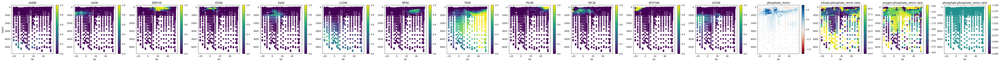

With max fractions


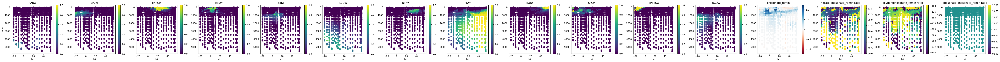

Uncertainty for endmembername: SPCW
With min fractions


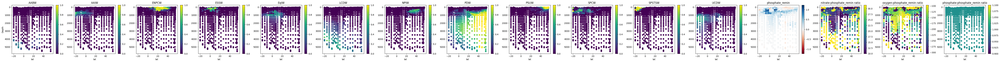

With max fractions


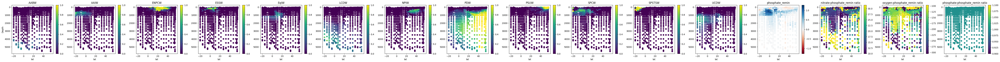

Uncertainty for endmembername: SPSTSW
With min fractions


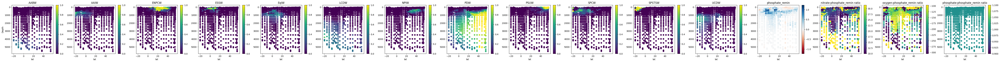

With max fractions


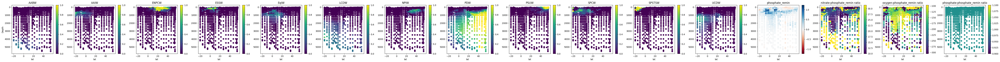

In [ ]:
#Put in the endmember names in the list to plot the uncertainty for them
for endmembername in ["AABW", "AAIW", "NPIW", "EqIW", "UCDW", "LCDW","PDW","PSUW",
                      "ENPCW", "ESSW", "SPCW", "SPSTSW"]:#all_endmembertypes:
  print("Uncertainty for endmembername:",endmembername)
  #print("Original")
  #plot_ompasoln_endmember_fractions(ompa_soln=base_combined,
  #                              xaxis_colname="lat",
  #                              yaxis_colname="Depth",
  #                              group_endmembers=True)
  print("With min fractions")
  plot_ompasoln_endmember_fractions(
      ompa_soln=combined_ambiguity_results_min[endmembername],
                                xaxis_colname="lat",
                                yaxis_colname="Depth",
                                group_endmembers=True)
  print("With max fractions")
  plot_ompasoln_endmember_fractions(
      ompa_soln=combined_ambiguity_results_max[endmembername],
                                xaxis_colname="lat",
                                yaxis_colname="Depth",
                                group_endmembers=True)

Download to hard drive

In [ ]:
from google.colab import files
import glob

!mkdir ompa_results
!mv *results.csv ompa_results
!zip -r ompa_results.zip ompa_results

  adding: ompa_results/ (stored 0%)
  adding: ompa_results/max_AABW_results.csv (deflated 61%)
  adding: ompa_results/baseresults.csv (deflated 62%)
  adding: ompa_results/min_PDW_results.csv (deflated 61%)
  adding: ompa_results/max_AAIW_results.csv (deflated 61%)
  adding: ompa_results/min_LCDW_results.csv (deflated 61%)
  adding: ompa_results/max_SPCW_results.csv (deflated 61%)
  adding: ompa_results/max_UCDW_results.csv (deflated 61%)
  adding: ompa_results/max_LCDW_results.csv (deflated 61%)
  adding: ompa_results/max_ENPCW_results.csv (deflated 60%)
  adding: ompa_results/max_EqIW_results.csv (deflated 61%)
  adding: ompa_results/min_UCDW_results.csv (deflated 61%)
  adding: ompa_results/max_SPSTSW_results.csv (deflated 64%)
  adding: ompa_results/min_AAIW_results.csv (deflated 60%)
  adding: ompa_results/max_PDW_results.csv (deflated 61%)
  adding: ompa_results/min_ENPCW_results.csv (deflated 60%)
  adding: ompa_results/min_SPCW_results.csv (deflated 60%)
  adding: ompa_results/